# RISS

In [21]:
import numpy as np
import pandas as pd
import astropy as apy
import matplotlib.pyplot as plt
import glob
import os

In [22]:
sources = pd.read_csv('RISS_sources.csv')

In [23]:
# Get the 'id' column
sources['id']

# Get the 'description' column
wavg_ra = sources['wavg_ra'].values
wavg_dec = sources['wavg_dec'].values


In [33]:
sources['id']

0      34129290
1      34129308
2      34129678
3      34129681
4      34129706
         ...   
706    35771363
707    35771398
708    35771409
709    35771683
710    35776493
Name: id, Length: 711, dtype: int64

## Testing Light Curve data

In [25]:
# First id light curve
test = pd.read_csv("lightcurves/src34129290.csv")

In [26]:
test

,# MJD,S
0,59897.7838,8.398
1,59902.7543,6.455
2,59919.7045,8.379
3,59934.6650,8.087
4,59950.6255,8.551
5,59964.5873,8.769
6,59978.5392,8.431
7,59979.5831,8.569
8,59993.4983,8.759
9,59997.4953,8.028


## Light Curve data

/tmp/ipykernel_263512/265140734.py:37: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(10, 6))


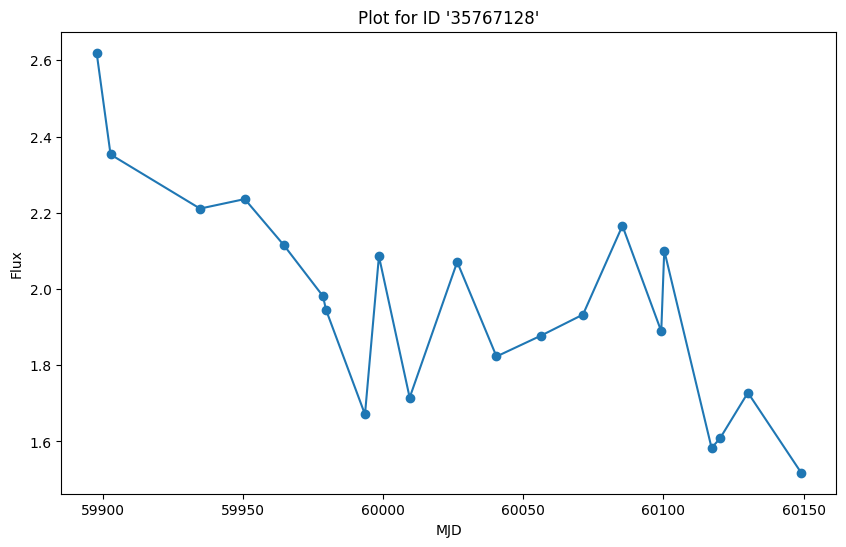

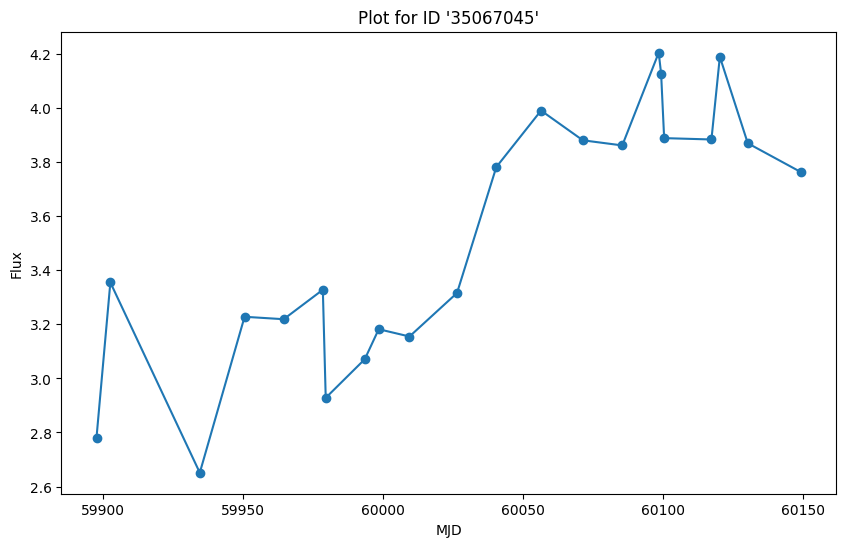

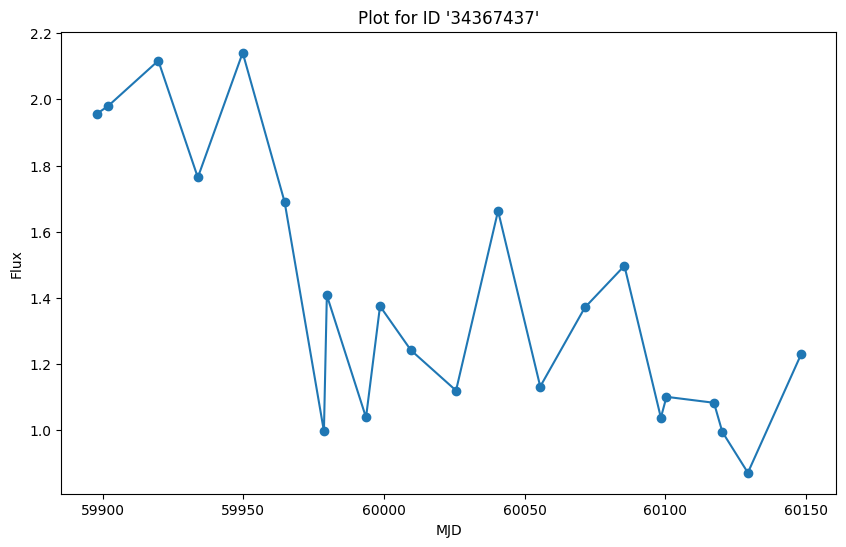

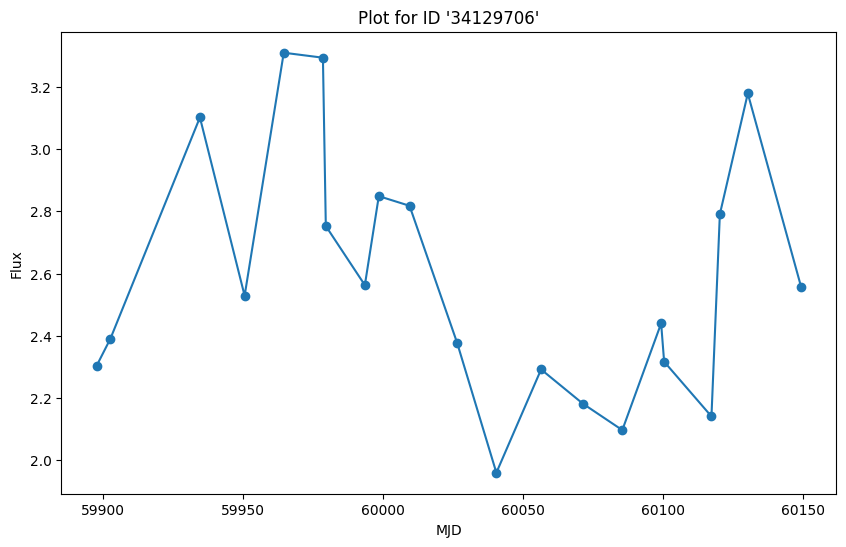

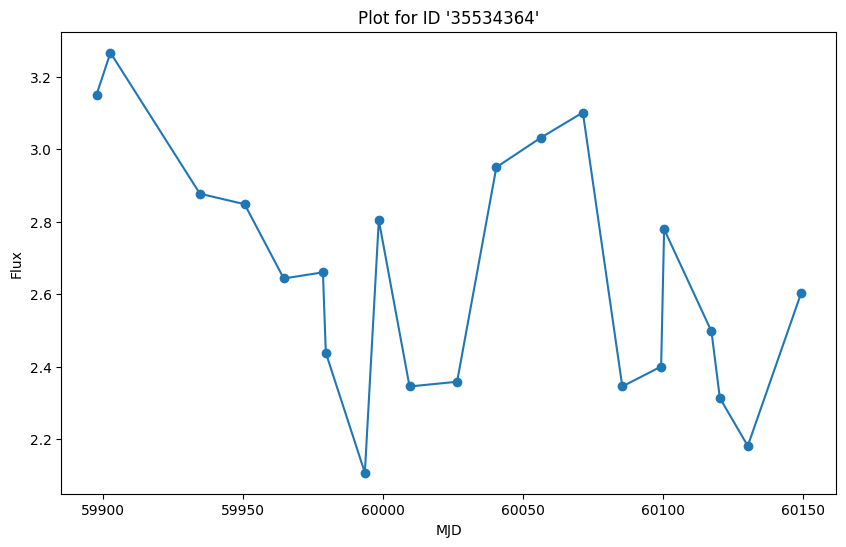

...

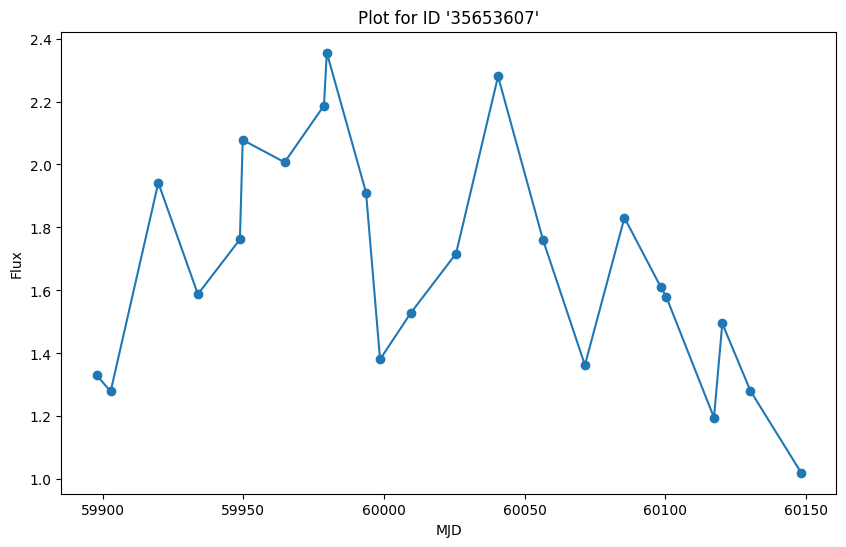

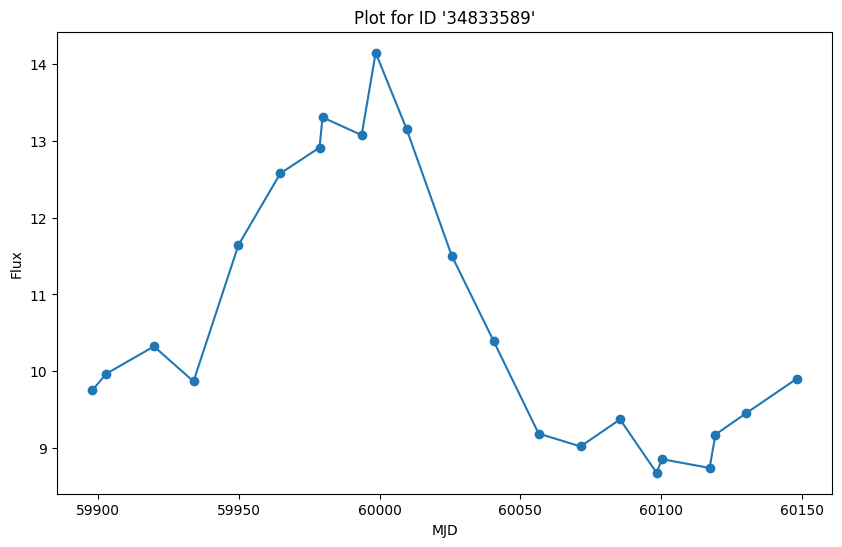

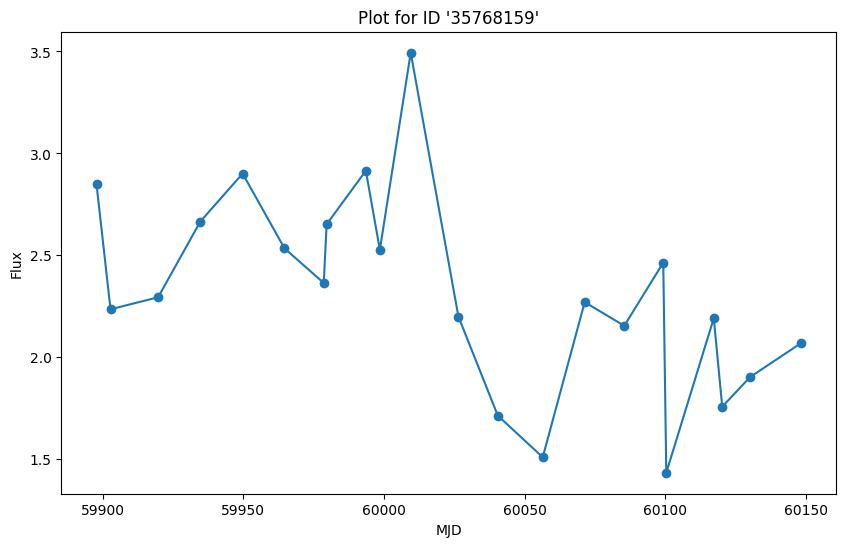

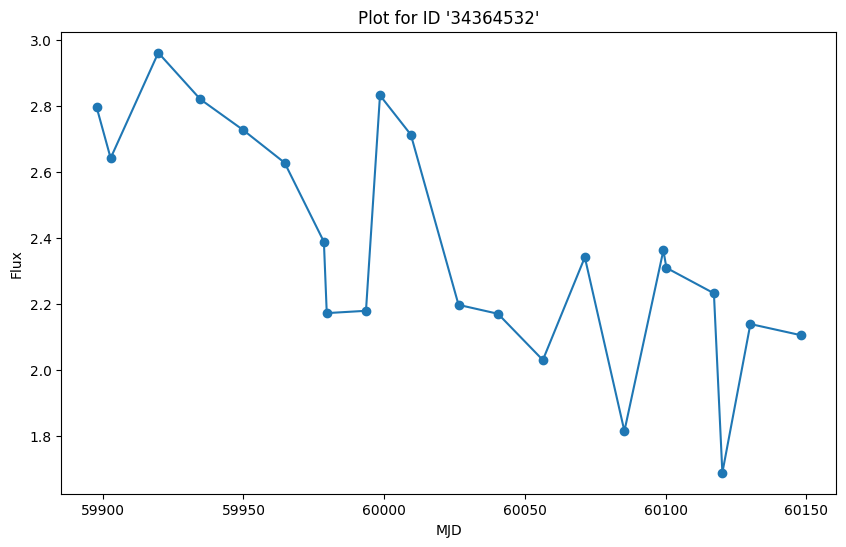

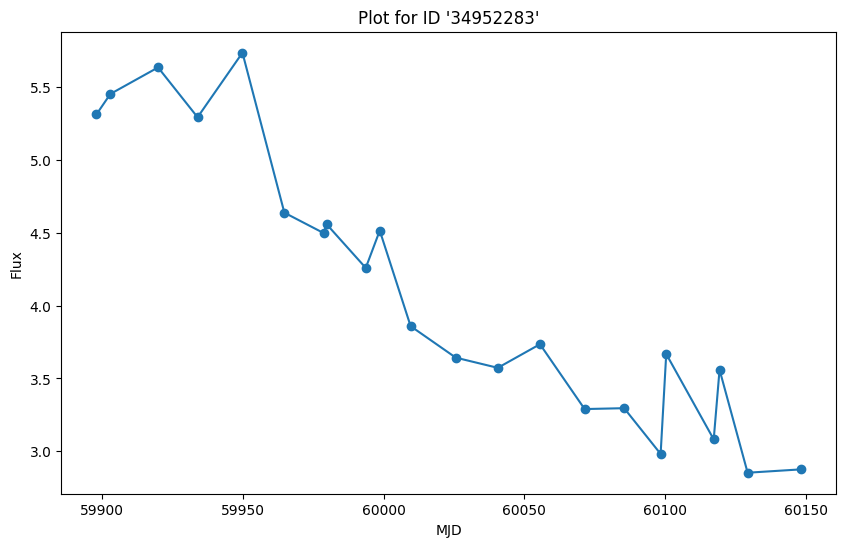

In [27]:
# Specify the path to the folder containing CSV files
folder_path = 'lightcurves/'

# List all CSV files in the folder
csv_files = [f for f in os.listdir(folder_path) if f.endswith('.csv')]

df_list = []
df_dict = {}
# Loop through each CSV file
for csv_file in csv_files:
    # Extract file name and use as DataFrame name
    df_name = os.path.splitext(csv_file)[0]

    # Remove the 'src' prefix from the DataFrame name
    if df_name.startswith('src'):
        df_name = df_name[3:]

    # Construct the full path to the CSV file
    file_path = os.path.join(folder_path, csv_file)

    # Read the CSV file into a DataFrame
    df = pd.read_csv(file_path)

    # Print the DataFrame
    # print(f"DataFrame '{df_name}':")
    # print(df)
    
    # Store DF in separate dictionaries
    df_dict[df_name] = df
    # print(df_dict)

    # Append DF to a list
    # df_list.append(df)
    # print(df_list)

    # Plot two specific columns
    plt.figure(figsize=(10, 6))
    plt.plot(df['# MJD'], df[' S'], marker='o', linestyle='-', label=f'DataFrame {df_name}')

    # Customize the plot as needed
    plt.title(f"Plot for ID '{df_name}'")
    plt.xlabel('MJD')
    plt.ylabel('Flux')
    # plt.legend()
    
    # Show the plot
    # plt.show()
    output_folder = 'lightcurves/plots/'
    output_path = os.path.join(output_folder, f"lightcurve_{df_name}.png")
    # Save plot
    # plt.savefig(output_path)

# Cross Correlation and Distance Calculation

In [28]:
# Create a list to store correlation results
correlation_results = []

# Create a list to store correlation, distance, and DataFrame name results
correlation_distance_results = []

# Calculate cross-correlation between Flux of each pair of DataFrames
for name1, df1 in df_dict.items():
    for name2, df2 in df_dict.items():
        if name1 != name2:  # Avoid comparing a DataFrame with itself
            # Specify the columns for cross-correlation
            column1 = '# MJD'
            column2 = ' S'

            # Calculate cross-correlation
            correlation = df1[column1].corr(df2[column2])

            # Append the result to the list
            correlation_results.append([name1, name2, correlation])
            

# Distance Comparison Histogram

In [ ]:
# Plot a histogram of RA and dec distances
plt.hist(result_df['Distance'], bins=20, edgecolor='black')
plt.xlabel('Distance')
plt.ylabel('Frequency of Correlation')
plt.title('Histogram of Correlation and Distances')
plt.show()